# Transformação de imagens

## 1. Requerimentos

Todas as bibliotecas já estão instaladas no Colab.

* OpenCV >= 4.4.0
* Matplotlib >= 3.1.3
* Seaborn >= 0.0.10
* Numpy >= 1.18.1

### 1.2 Arquivos

Baixe o repositório do GitHub utilizando o comando abaixo. Em caso de atualização, utilize o comando para apagar o diretório antes.

In [44]:
!rm -rf fiap-ml-visao-computacional/

In [45]:
!git clone https://github.com/FIAPON/fiap-ml-visao-computacional.git

Cloning into 'fiap-ml-visao-computacional'...
remote: Enumerating objects: 64957, done.
remote: Counting objects: 100% (876/876), done.
remote: Compressing objects: 100% (728/728), done.
remote: Total 64957 (delta 157), reused 852 (delta 134), pack-reused 64081 (from 1)
Receiving objects: 100% (64957/64957), 668.96 MiB | 28.81 MiB/s, done.
Resolving deltas: 100% (172/172), done.
Updating files: 100% (66517/66517), done.


Vamos agora posicionar o diretório do repositório para a aula respectiva. Nesse caso envie o comando de mudança de diretório.

In [46]:
%cd fiap-ml-visao-computacional/aula-2-transformacao/

/content/fiap-ml-visao-computacional/aula-2-transformacao/fiap-ml-visao-computacional/aula-2-transformacao


Importação das bibliotecas.

In [47]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import cv2

#Exibição na mesma tela do Jupyter
%matplotlib inline

sns.set_style("whitegrid", {'axes.grid' : False})

## 2. Rotação

Carregando uma imagem previamente existente.
Documento (imagem) utilizado no repositório de [JPLeoRX](https://github.com/JPLeoRX/opencv-text-deskew)

Text(0.5, 1.0, 'Documento')

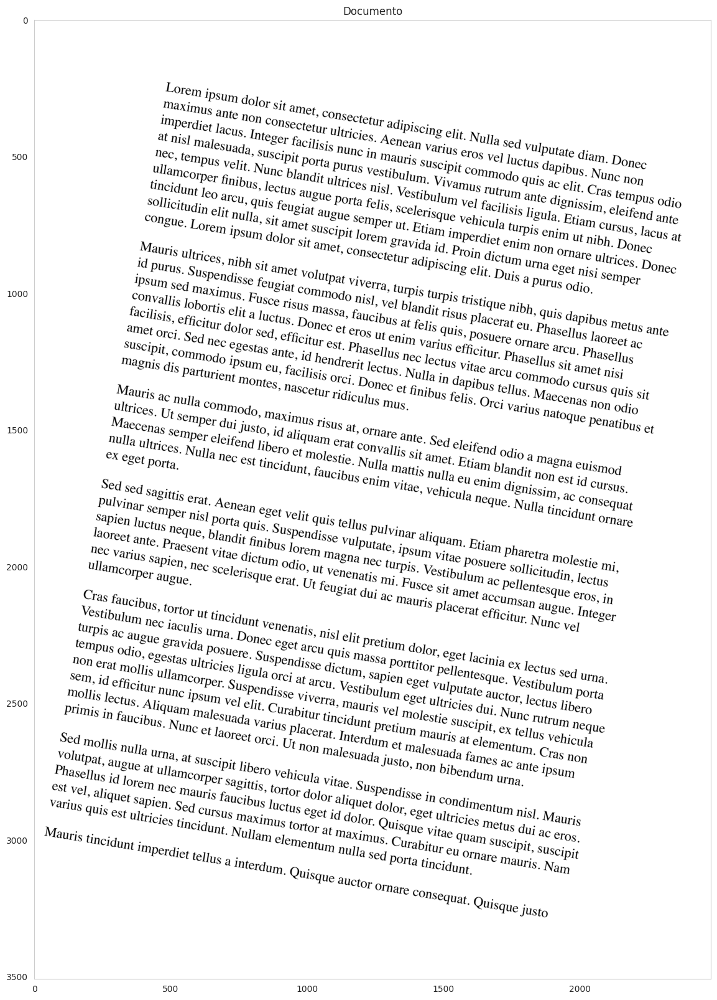

In [48]:
imagem = cv2.imread("imagens/documento.png")
imagem = cv2.cvtColor(imagem, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(30,20))
plt.imshow(imagem)
plt.title("Documento")

Aplicando matriz de rotação e incluindo na transformação afim.

In [49]:
height, width = imagem.shape[:2]
matriz_rotacao = cv2.getRotationMatrix2D((50, 3000), 10, 1)
print(matriz_rotacao)

[[ 9.84807753e-01  1.73648178e-01 -5.20184921e+02]
 [-1.73648178e-01  9.84807753e-01  5.42591498e+01]]


Text(0.5, 1.0, 'Robô Rotacionado')

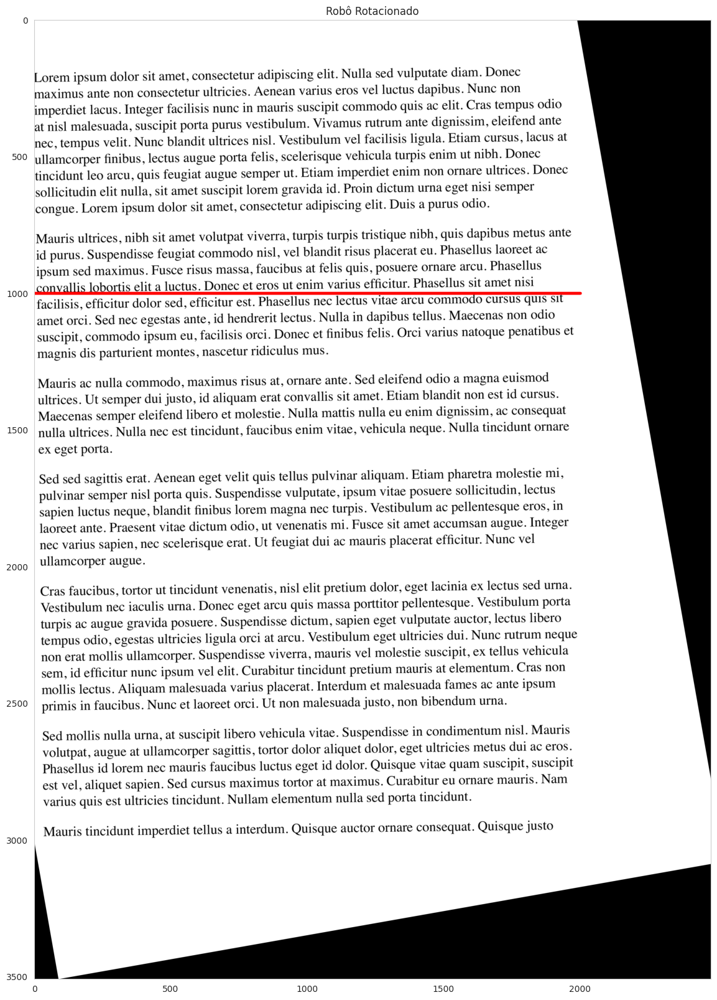

In [50]:
imagem_rotacionada = cv2.warpAffine(imagem, matriz_rotacao, (width, height))

cv2.line(imagem_rotacionada,(0,1000), (2000,1000), (255, 0, 0), 10)

plt.figure(figsize=(30,20))
plt.imshow(imagem_rotacionada)
plt.title("Robô Rotacionado")

Text(0.5, 1.0, 'Robô Rotacionado')

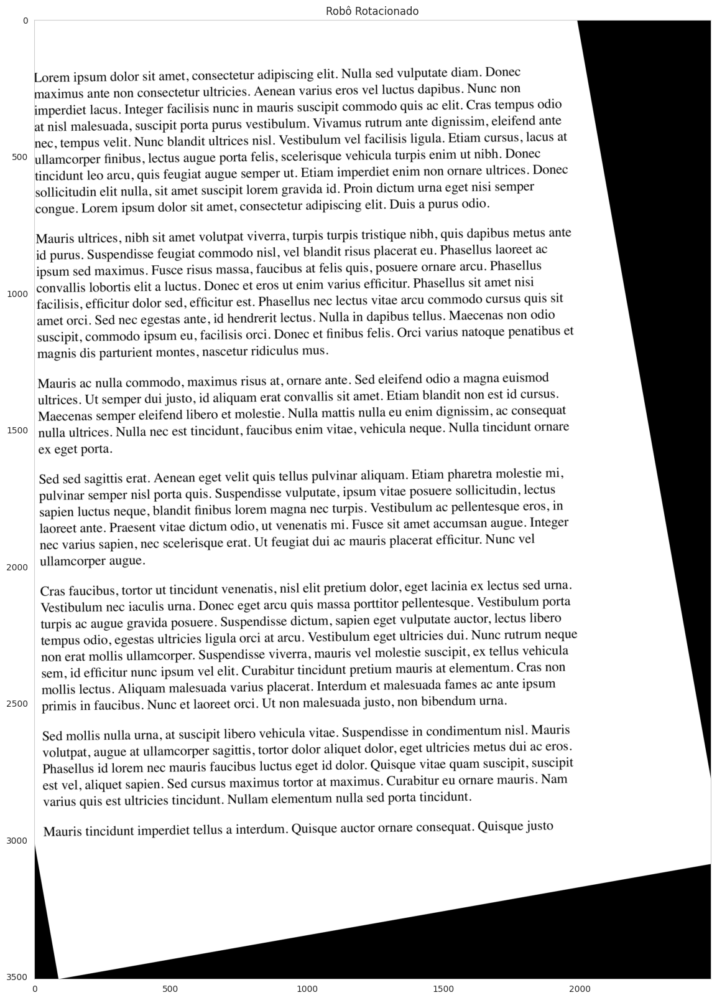

In [51]:
imagem_rotacionada = cv2.warpAffine(imagem, matriz_rotacao, (width, height))

plt.figure(figsize=(30,20))
plt.imshow(imagem_rotacionada)
plt.title("Robô Rotacionado")

Text(0.5, 1.0, 'Robô Rotacionado')

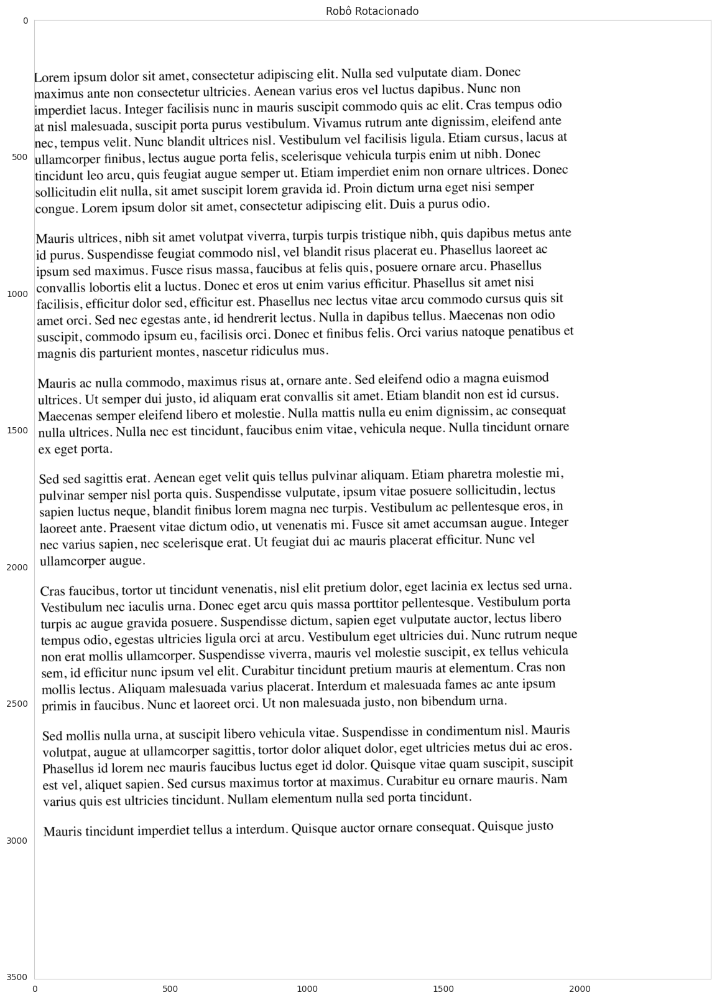

In [52]:
imagem_rotacionada = cv2.warpAffine(imagem, matriz_rotacao, (width, height), borderValue=(255,255,255))

plt.figure(figsize=(30,20))
plt.imshow(imagem_rotacionada)
plt.title("Robô Rotacionado")

## 2. Translação

Carregando uma imagem previamente existente

Text(0.5, 1.0, 'Documento Rotacionado')

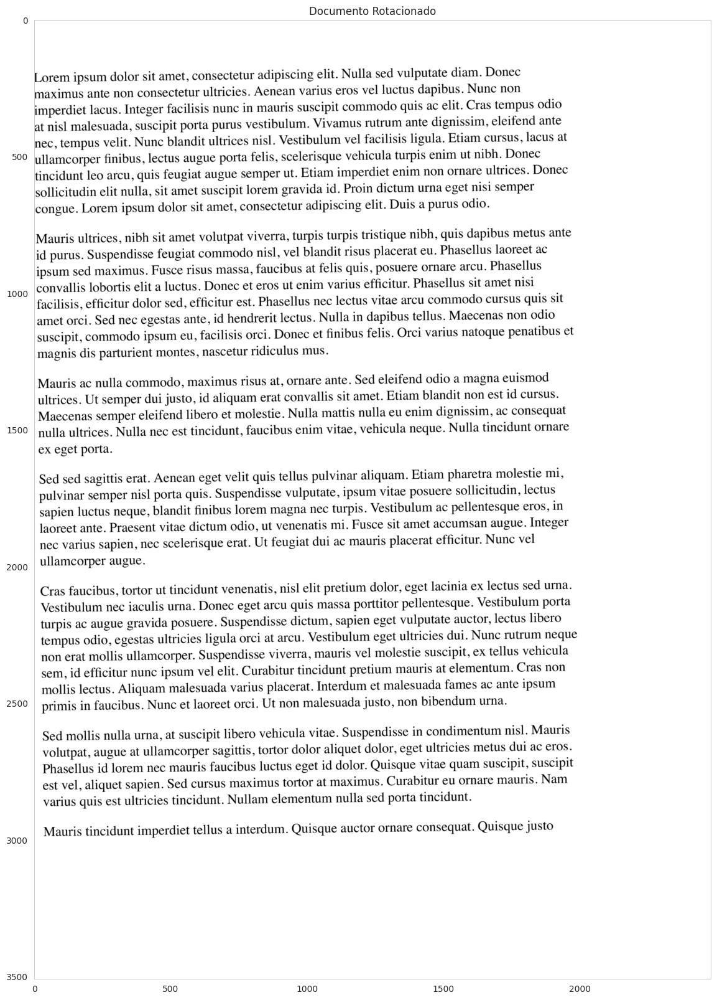

In [53]:
plt.figure(figsize=(30,20))
plt.imshow(imagem_rotacionada)
plt.title("Documento Rotacionado")

Aplicando translação, sempre em paralelo nos eixos x e y. Neste caso utilizando valores positivos.

In [54]:
height, width = imagem.shape[:2]

#Vamos alterar o tamanho para a 25% do original
height_alterado, width_alterado = height/4, width/4

# Matriz de translação
matriz_translacao = np.float32([[1, 0, 200],[0, 1, 0]])

print(matriz_translacao)

[[  1.   0. 200.]
 [  0.   1.   0.]]


Text(0.5, 1.0, 'Documento Translação')

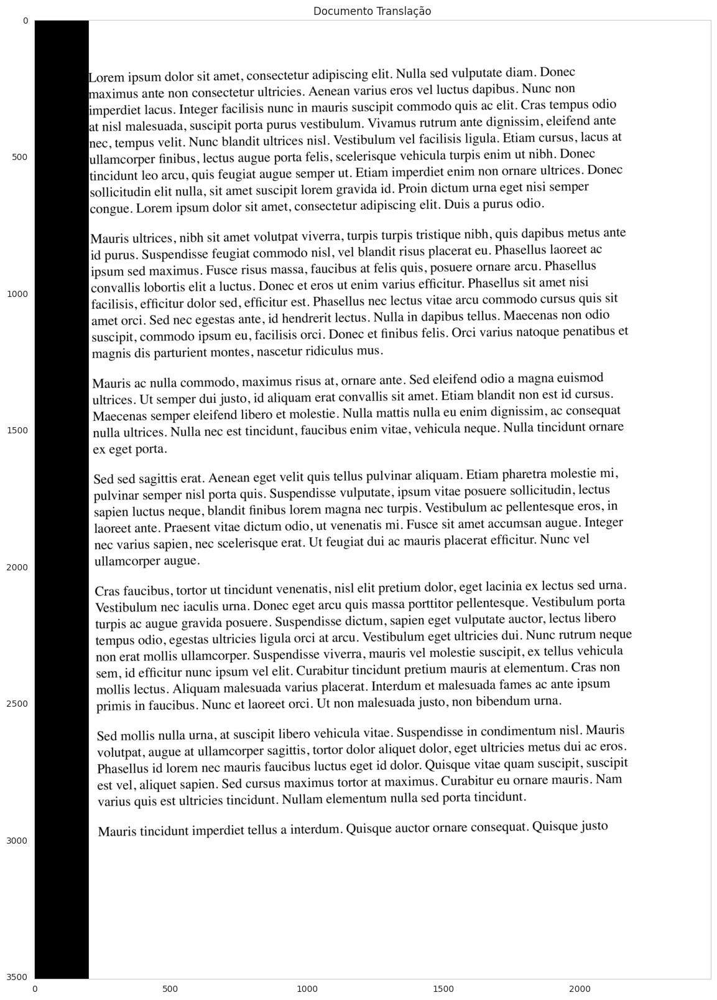

In [55]:
imagem_transladada = cv2.warpAffine(imagem_rotacionada, matriz_translacao, (width, height))

plt.figure(figsize=(30,20))
plt.imshow(imagem_transladada)
plt.title("Documento Translação")

Text(0.5, 1.0, 'Documento Translação')

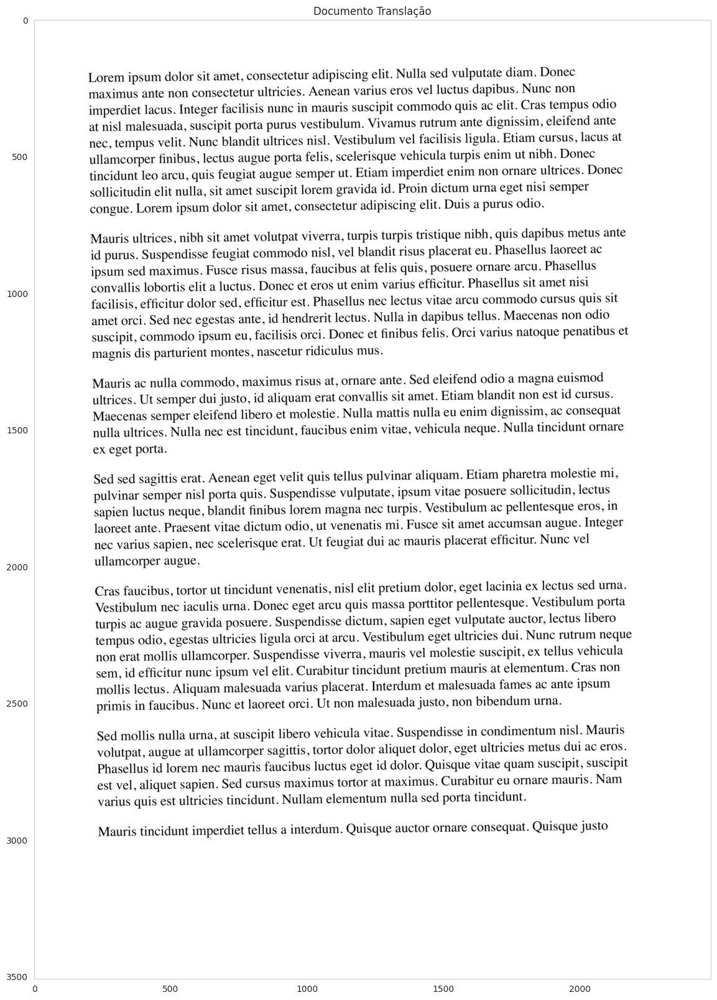

In [56]:
imagem_transladada = cv2.warpAffine(imagem_rotacionada, matriz_translacao, (width, height), borderValue=(255,255,255))

plt.figure(figsize=(30,20))
plt.imshow(imagem_transladada)
plt.title("Documento Translação")

Aplicando translação no sentido inverso, utilizando valores negativos.

In [57]:
matriz_translacao = np.float32([[1, 0, -300],[0, 1, -100]])

# Matriz de translação
print(matriz_translacao)

[[   1.    0. -300.]
 [   0.    1. -100.]]


Text(0.5, 1.0, 'Documento Translação')

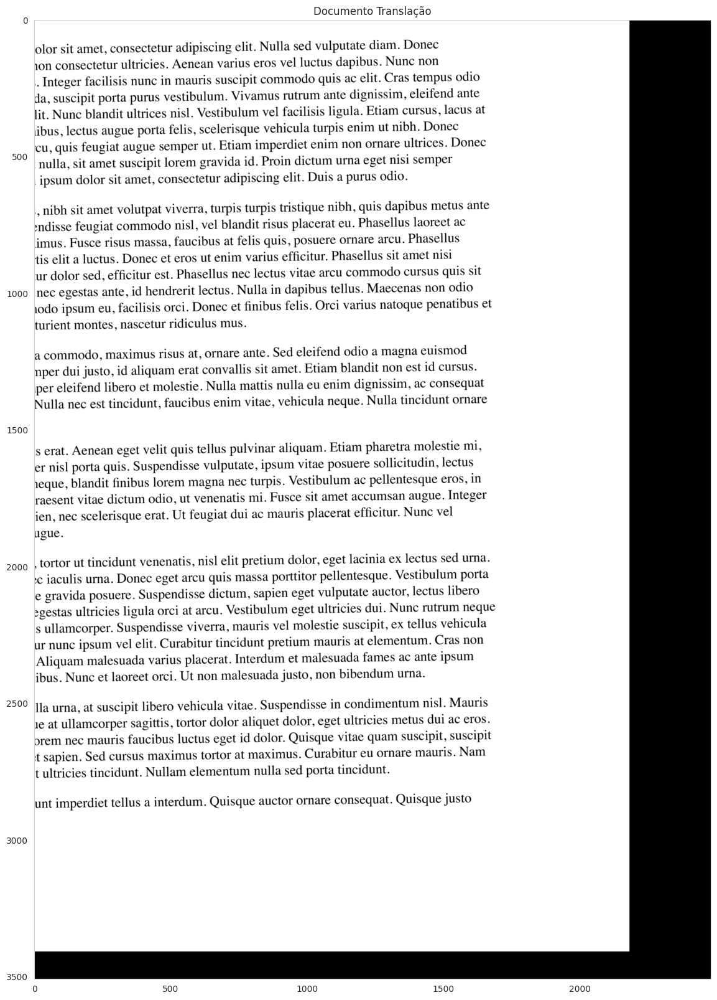

In [58]:
imagem_transladada = cv2.warpAffine(imagem_rotacionada, matriz_translacao, (width, height))

plt.figure(figsize=(30,20))
plt.imshow(imagem_transladada)
plt.title("Documento Translação")

## 4. Redimensionamento e Interpolação

O redimensionamento de imagens pode utilizar uma série de interpolações que servem para cobrir os pixels que são expandidos. Cada tipo de interpolação traz aspectos de maior nitidez e velocidade de processamento.

*Os experimentos abaixo foram adaptados deste [link](http://tanbakuchi.com/posts/comparison-of-openv-interpolation-algorithms), de Anthony Tanbakuchi.*

Carregando uma imagem previamente existente

Text(0.5, 1.0, 'Café Original (Pequeno)')

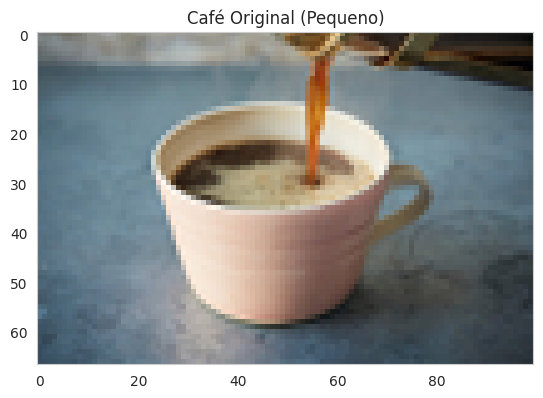

In [59]:
imagem = cv2.imread("imagens/coffee_small.jpg")
imagem = cv2.cvtColor(imagem, cv2.COLOR_BGR2RGB)

plt.imshow(imagem)
plt.title("Café Original (Pequeno)")

Escala por fator (multiplicação)

Text(0.5, 1.0, 'Ampliação Lanczo')

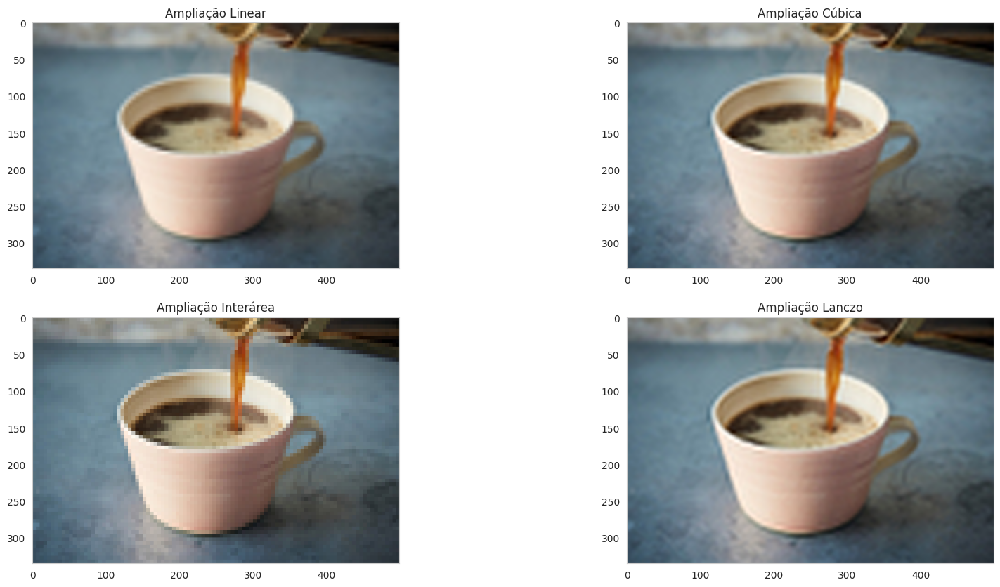

In [60]:
fator_x=5
fator_y=5

imagem_nova_linear = cv2.resize(imagem, None, fx=fator_x, fy=fator_y)
imagem_nova_cubica = cv2.resize(imagem, None, fx=fator_x, fy=fator_y, interpolation=cv2.INTER_CUBIC)
imagem_nova_area = cv2.resize(imagem, None, fx=fator_x, fy=fator_y, interpolation=cv2.INTER_AREA)
imagem_nova_lanczo = cv2.resize(imagem, None, fx=fator_x, fy=fator_y, interpolation=cv2.INTER_LANCZOS4)

plt.figure(figsize=(20,10))
plt.subplot(2,2,1)
plt.imshow(imagem_nova_linear)
plt.title("Ampliação Linear")

plt.subplot(2,2,2)
plt.imshow(imagem_nova_cubica)
plt.title("Ampliação Cúbica")

plt.subplot(2,2,3)
plt.imshow(imagem_nova_area)
plt.title("Ampliação Interárea")

plt.subplot(2,2,4)
plt.imshow(imagem_nova_lanczo)
plt.title("Ampliação Lanczo")

Escala por novo tamanho.

Text(0.5, 1.0, 'Ampliação Lanczo')

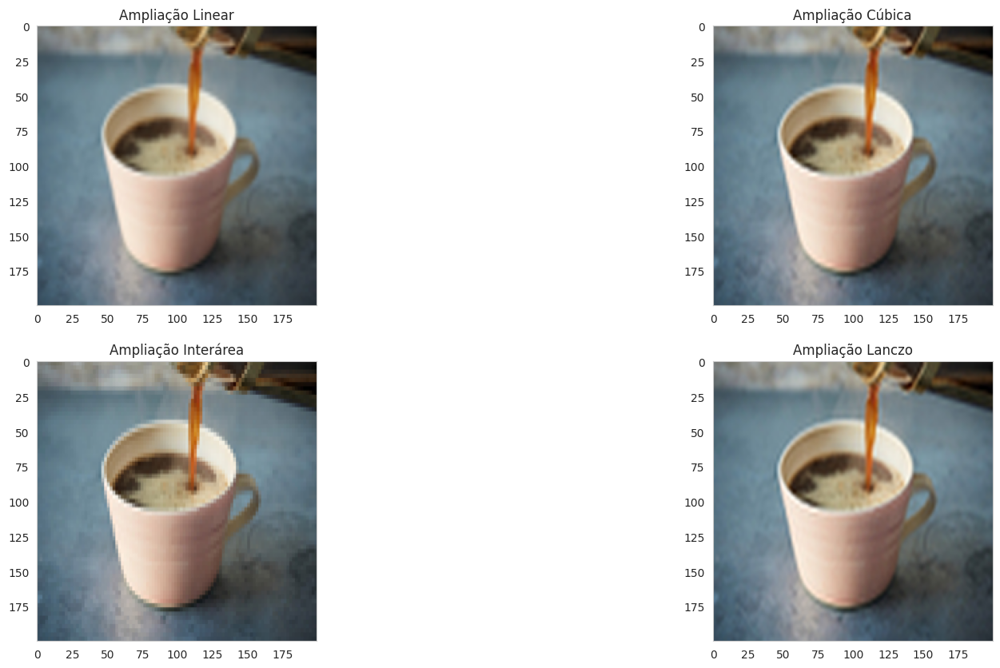

In [61]:
novo_tamanho = (200,200)

imagem_nova_linear = cv2.resize(imagem, novo_tamanho)
imagem_nova_cubica = cv2.resize(imagem, novo_tamanho, interpolation=cv2.INTER_CUBIC)
imagem_nova_interarea = cv2.resize(imagem, novo_tamanho, interpolation=cv2.INTER_AREA)
imagem_nova_lanczo = cv2.resize(imagem, novo_tamanho, interpolation=cv2.INTER_LANCZOS4)

plt.figure(figsize=(20,10))
plt.subplot(2,2,1)
plt.imshow(imagem_nova_linear)
plt.title("Ampliação Linear")

plt.subplot(2,2,2)
plt.imshow(imagem_nova_cubica)
plt.title("Ampliação Cúbica")

plt.subplot(2,2,3)
plt.imshow(imagem_nova_interarea)
plt.title("Ampliação Interárea")

plt.subplot(2,2,4)
plt.imshow(imagem_nova_lanczo)
plt.title("Ampliação Lanczo")

## 5. Transformação Homográfica (Não-Afim)


Text(0.5, 1.0, 'Cheque')

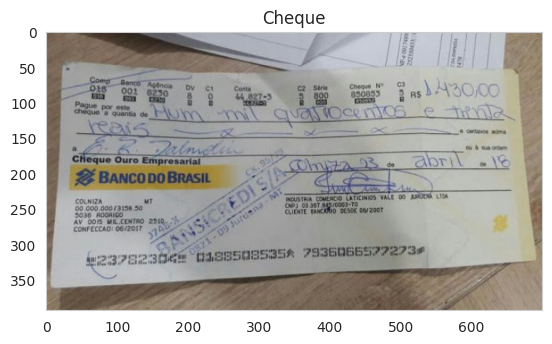

In [62]:
imagem = cv2.imread("imagens/cheque.jpg")
imagem = cv2.cvtColor(imagem, cv2.COLOR_BGR2RGB)

plt.imshow(imagem)
plt.title("Cheque")

Pontos no sentido horário, começando pelo superior a esquerda.

Text(0.5, 1.0, 'Cheque com Marcadores')

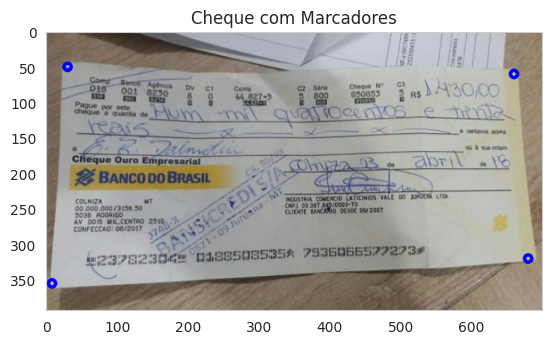

In [63]:
imagem_marcadores = imagem.copy()

p1 = (30,50)
p2 = (660, 60)
p3 = (8, 355)
p4 = (680, 320)

tamanho_final = (700, 300)

pontos_marcadores = np.float32([p1,p2,p3,p4])
pontos_destino = np.float32([(0,0),(tamanho_final[0],0),(0,tamanho_final[1]),tamanho_final])

# Adicionando marcadores para visualizar os pontos que serão expandidos

cv2.circle(imagem_marcadores, p1, 5, (0, 0, 255), 3)
cv2.circle(imagem_marcadores, p2, 5, (0, 0, 255), 3)
cv2.circle(imagem_marcadores, p3, 5, (0, 0, 255), 3)
cv2.circle(imagem_marcadores, p4, 5, (0, 0, 255), 3)

plt.imshow(imagem_marcadores)
plt.title("Cheque com Marcadores")

Text(0.5, 1.0, 'Portal com Marcadores')

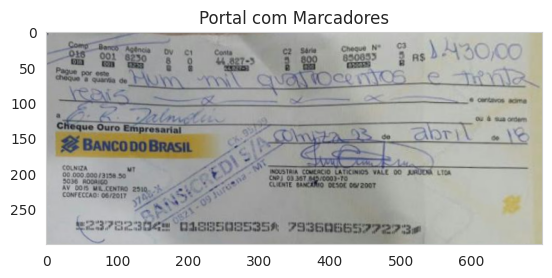

In [64]:
# Realizando a transformação não afim

matriz_perspectiva = cv2.getPerspectiveTransform(pontos_marcadores, pontos_destino)
imagem_transformada = cv2.warpPerspective(imagem, matriz_perspectiva, tamanho_final)

plt.imshow(imagem_transformada)
plt.title("Portal com Marcadores")

## 6. Recorte de imagens e região de interesse (ROI)

No OpenCV não existe uma função própria para recortar segmentos de uma imagem. Por outro lado, conseguimos fazer esta tarefa fácilmente aplicando diretamente na matriz da imagem as alterações.

Text(0.5, 1.0, 'Imagem Original')

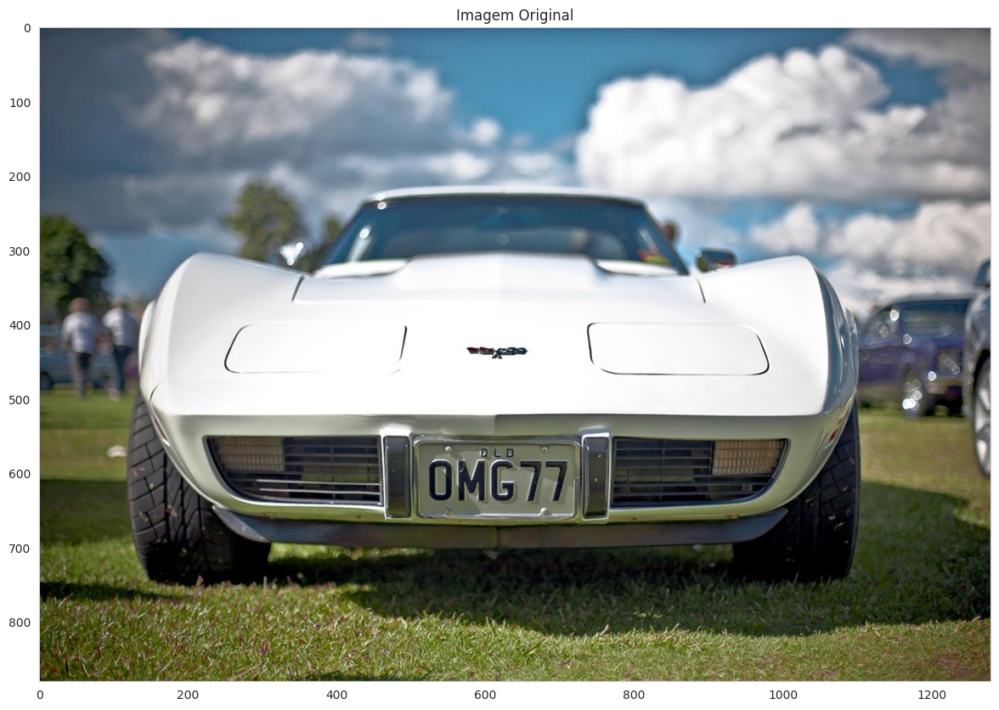

In [65]:
imagem = cv2.imread("imagens/car.jpg")
imagem = cv2.cvtColor(imagem, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(20,10))
plt.imshow(imagem)
plt.title("Imagem Original")

Text(0.5, 1.0, 'Imagem Recortada')

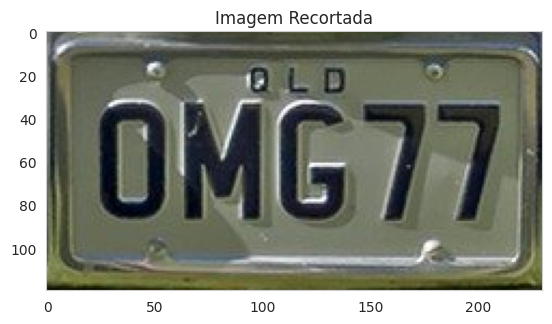

In [66]:
linha_y_inicio, coluna_x_inicio = 550, 500
linha_y_final, coluna_x_final =  670, 730

imagem_recortada = imagem[linha_y_inicio:linha_y_final, coluna_x_inicio:coluna_x_final]

plt.imshow(imagem_recortada)
plt.title("Imagem Recortada")

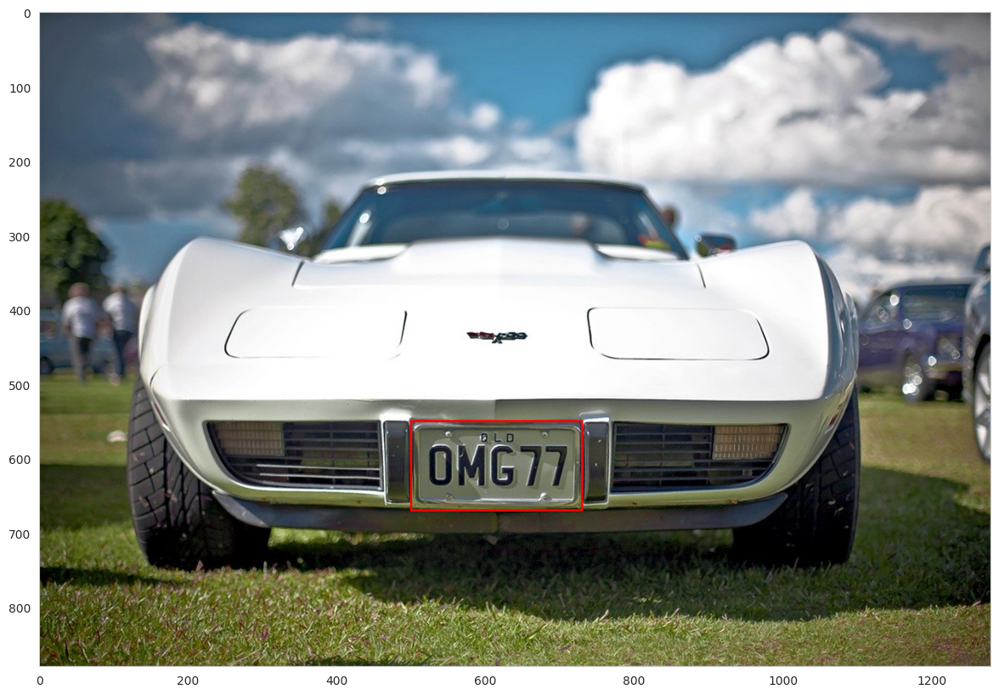

In [67]:
imagem_anotada = imagem.copy()
cv2.rectangle(imagem_anotada,(coluna_x_inicio,linha_y_inicio), (coluna_x_final,linha_y_final), (255, 0, 0), 2)

plt.figure(figsize=(20,10))
plt.imshow(imagem_anotada)

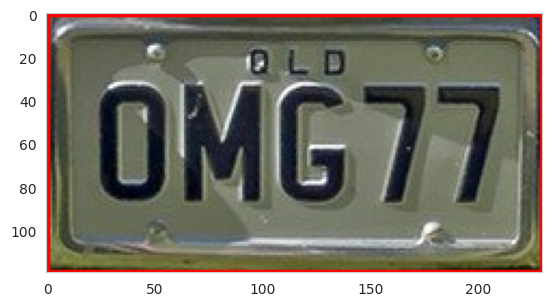

In [68]:
roi = imagem_anotada[linha_y_inicio:linha_y_final, coluna_x_inicio:coluna_x_final]

plt.imshow(roi)

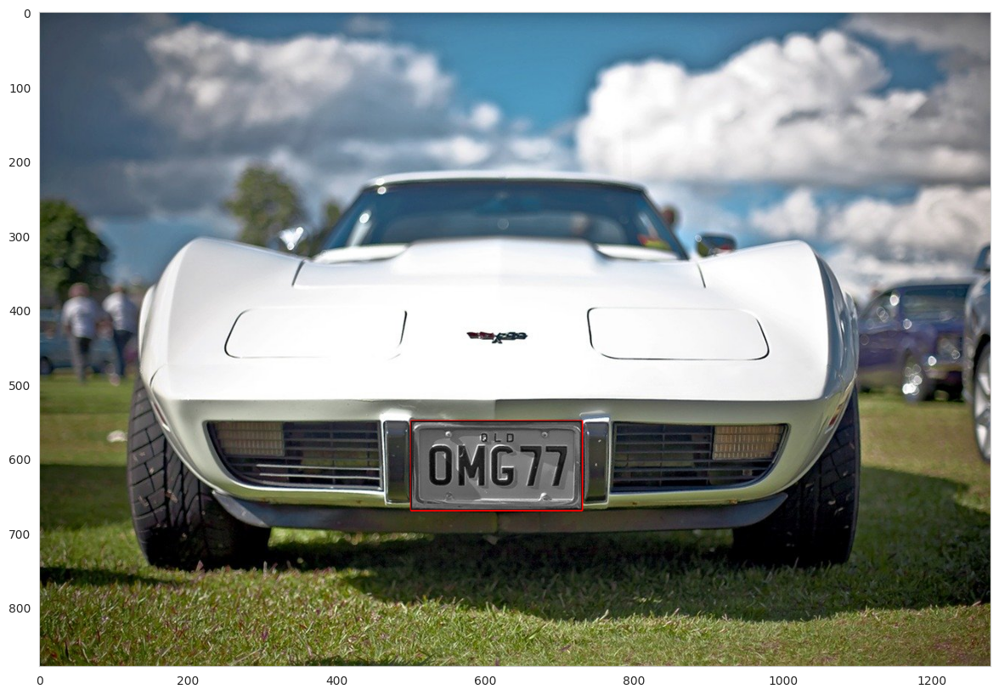

In [69]:
roi = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
roi = cv2.cvtColor(roi, cv2.COLOR_GRAY2BGR)

imagem_anotada[linha_y_inicio:linha_y_final, coluna_x_inicio:coluna_x_final] = roi

plt.figure(figsize=(20,10))
plt.imshow(imagem_anotada)

Exemplo de extração de região de interesse para detecção e identificação de faces em Hong Kong, [fonte](https://www.aljazeera.com/news/2019/12/8/giant-rally-marks-six-months-of-hong-kongs-democracy-protests).

Text(0.5, 1.0, 'Imagem Original')

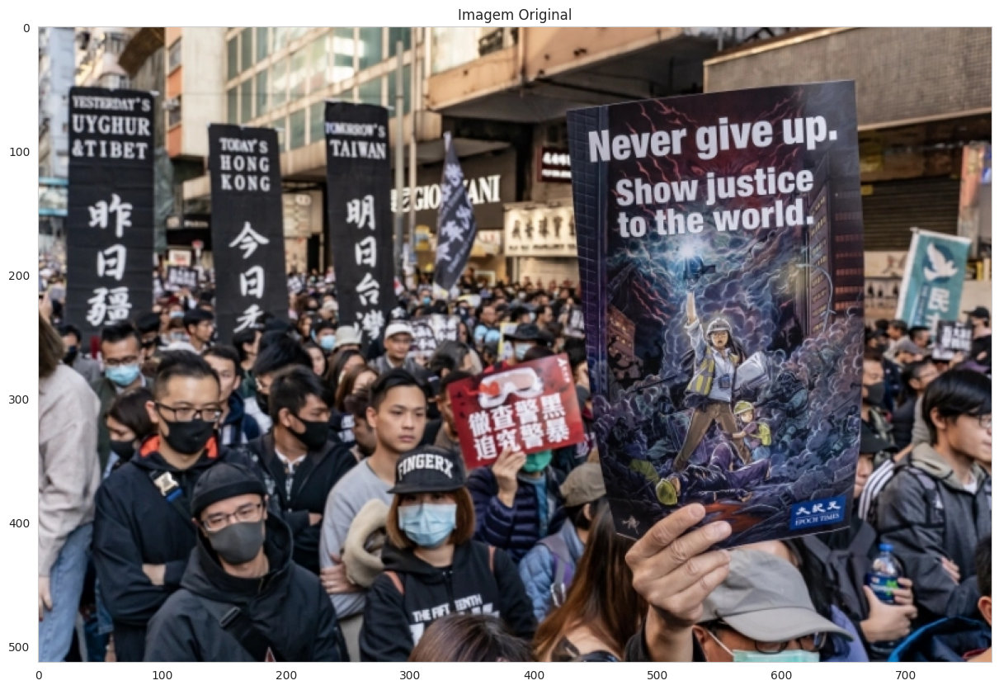

In [70]:
imagem = cv2.imread("imagens/protesters.png")
imagem = cv2.cvtColor(imagem, cv2.COLOR_BGR2RGB)

plt.figure(figsize=(20,10))
plt.imshow(imagem)
plt.title("Imagem Original")

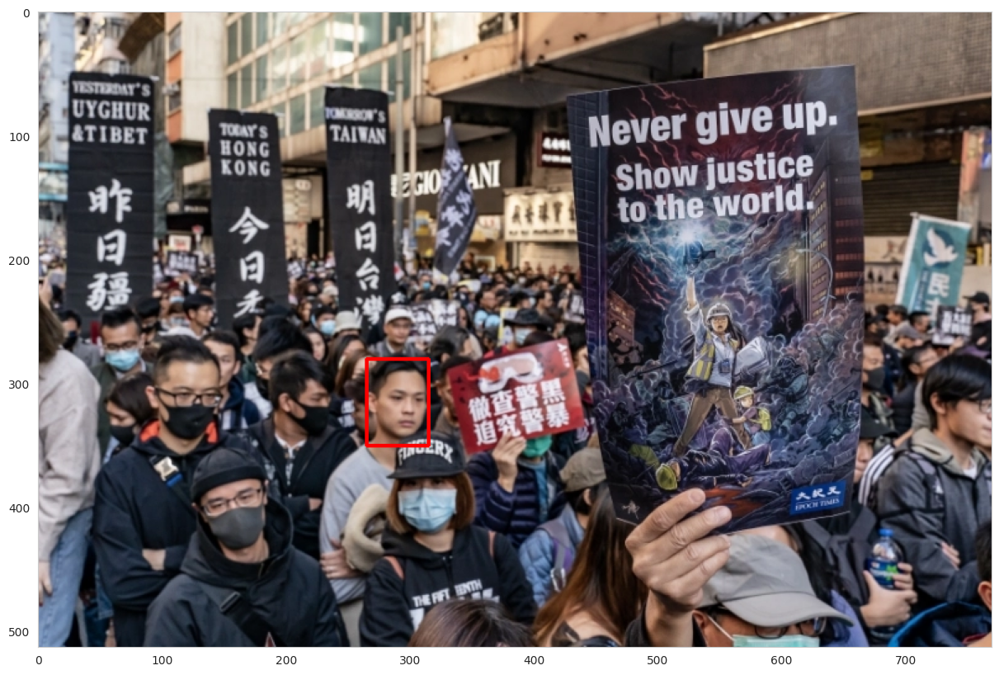

In [71]:
linha_y_inicio, coluna_x_inicio = 280, 265
linha_y_final, coluna_x_final =  350, 315

imagem_anotada = imagem.copy()
cv2.rectangle(imagem_anotada,(coluna_x_inicio,linha_y_inicio), (coluna_x_final,linha_y_final), (255, 0, 0), 2)

plt.figure(figsize=(20,10))
plt.imshow(imagem_anotada)

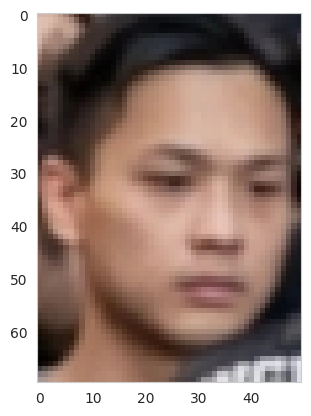

In [72]:
roi = imagem[linha_y_inicio:linha_y_final, coluna_x_inicio:coluna_x_final]

plt.imshow(roi)

## 7. Alterando brilho (nitidez) de uma imagem

Refere-se a tornar a imagem mais clara.
Imagem utilizada do filme Lighthouse, [fonte](https://berkreviews.com/2019/11/25/the-stars-shine-bright-in-the-lighthouse-2019-despite-the-dark-content/).

Text(0.5, 1.0, 'Imagem Original')

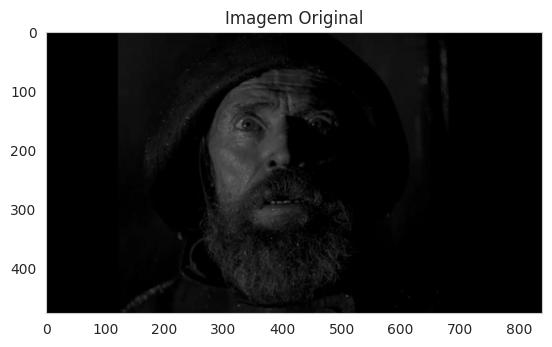

In [73]:
imagem = cv2.imread("imagens/lighthouse.jpeg")
imagem = cv2.cvtColor(imagem, cv2.COLOR_BGR2RGB)

imagem_shape = imagem.shape

plt.imshow(imagem)
plt.title("Imagem Original")

Text(0.5, 1.0, 'Imagem Brilho')

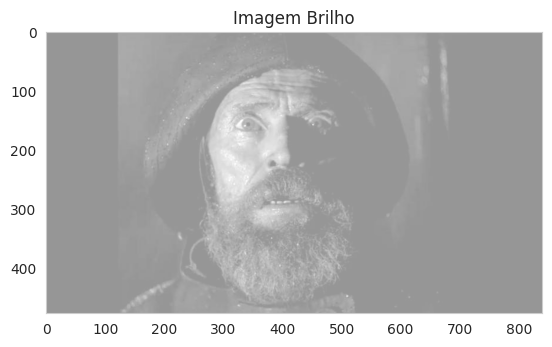

In [74]:
matriz_brilho = np.ones(imagem_shape, np.uint8) * 150
imagem_brilho = cv2.add(imagem, matriz_brilho)

plt.imshow(imagem_brilho)
plt.title("Imagem Brilho")

Text(0.5, 1.0, 'Imagem Escura')

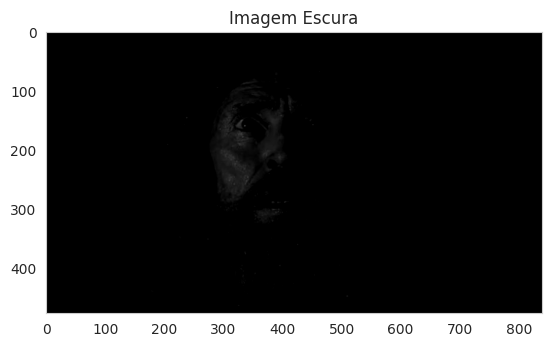

In [75]:
matriz_brilho = np.ones(imagem_shape, np.uint8) * 50
imagem_escura = cv2.subtract(imagem, matriz_brilho)

plt.imshow(imagem_escura)
plt.title("Imagem Escura")

## 8. Operações lógicas

As operações lógicas ou bitwise operations são operações do tipo and, or, xor e not. São utilizadas na composição de 2 imagens, criar máscaras e intersecções.

Text(0.5, 1.0, 'Retangulo')

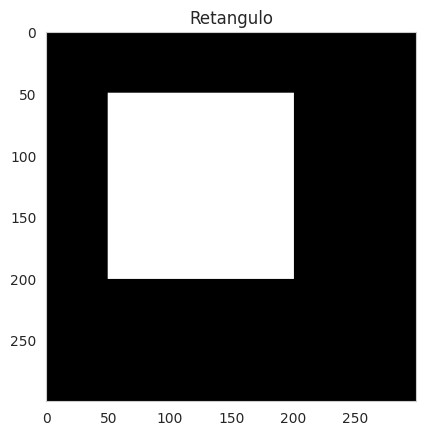

In [76]:
retangulo = np.zeros((300,300), np.uint8)
cv2.rectangle(retangulo, (50,50), (200,200), 255, -2)

plt.imshow(retangulo, cmap="gray")
plt.title("Retangulo")

Text(0.5, 1.0, 'Círculo')

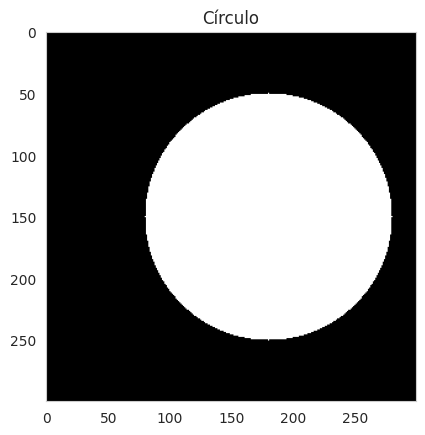

In [77]:
circulo = np.zeros((300,300), np.uint8)
cv2.circle(circulo,(180,150), 100, 255, -2)

plt.imshow(circulo, cmap="gray")
plt.title("Círculo")

Text(0.5, 1.0, 'Operação And (E)')

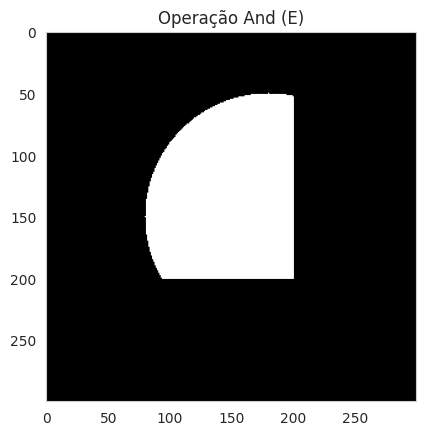

In [78]:
operacao_and = cv2.bitwise_and(retangulo, circulo)

plt.imshow(operacao_and, cmap="gray")
plt.title("Operação And (E)")

Text(0.5, 1.0, 'Operação Or (Ou)')

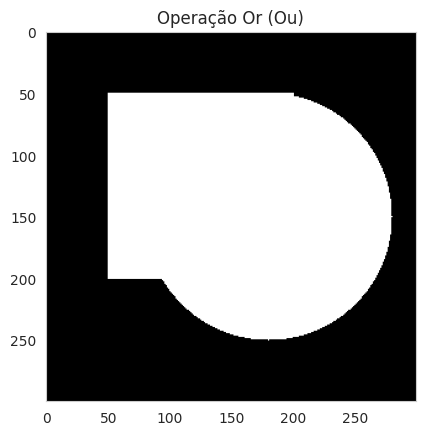

In [79]:
operacao_or = cv2.bitwise_or(retangulo, circulo)

plt.imshow(operacao_or, cmap="gray")
plt.title("Operação Or (Ou)")

Text(0.5, 1.0, 'Operação Xor (Ou Exclusivo)')

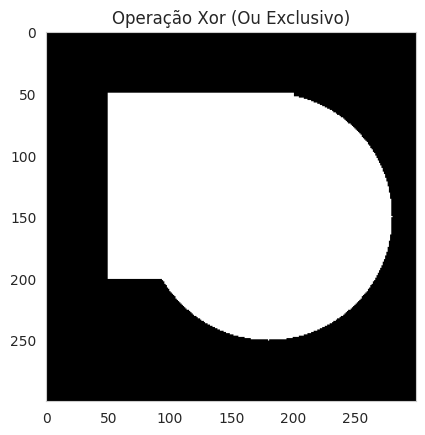

In [80]:
operacao_xor = cv2.bitwise_xor(retangulo, circulo)

plt.imshow(operacao_or, cmap="gray")
plt.title("Operação Xor (Ou Exclusivo)")

Text(0.5, 1.0, 'Operação Not (Negação)')

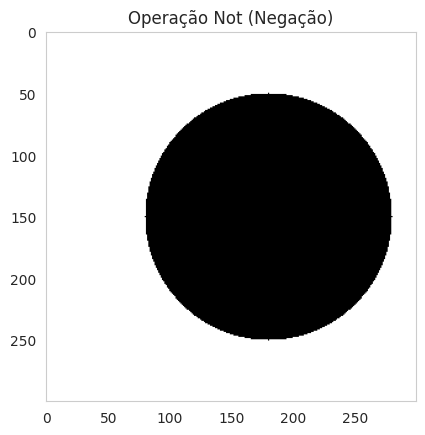

In [81]:
operacao_negacao = cv2.bitwise_not(circulo)

plt.imshow(operacao_negacao, cmap="gray")
plt.title("Operação Not (Negação)")

## Usando a webcam para filtrar a cor vermelha do espaço de cor HSV

O espaço de cor HSV (Hue, Saturation, Value) é uma representação alternativa ao tradicional RGB (Red, Green, Blue). Ele facilita a manipulação de cores, pois separa o tom (Hue), a saturação (Saturation) e a luminosidade (Value), tornando-o ideal para tarefas como detecção de cores em visão computacional.

### Por que usar HSV?

No modelo RGB, identificar cores específicas pode ser desafiador, já que as três componentes (vermelho, verde e azul) estão interligadas. O espaço HSV, por outro lado, permite selecionar cores com maior precisão, utilizando apenas o componente Hue para representar o tom principal da cor

In [83]:
import cv2
import numpy as np
import base64
from google.colab import output
from IPython.display import display, Javascript, Image
from PIL import Image as PILImage
from io import BytesIO

# Função para capturar imagem da webcam
def capture_image():
    js = Javascript('''
        async function takePhoto() {
            const div = document.createElement('div');
            document.body.appendChild(div);

            const video = document.createElement('video');
            video.style.display = 'none';
            div.appendChild(video);

            const stream = await navigator.mediaDevices.getUserMedia({video: true});
            video.srcObject = stream;
            await video.play();

            // Espera alguns segundos para dar tempo de ativar a webcam
            await new Promise(resolve => setTimeout(resolve, 1000));

            const canvas = document.createElement('canvas');
            canvas.width = video.videoWidth;
            canvas.height = video.videoHeight;
            canvas.getContext('2d').drawImage(video, 0, 0);
            stream.getVideoTracks()[0].stop();
            div.remove();

            return canvas.toDataURL('image/jpeg', 0.8);
        }

        takePhoto();
    ''')
    display(js)

capture_image()

# Baixa a imagem da webcam
def get_image():
    img_str = output.eval_js("takePhoto()")
    img_data = BytesIO(base64.b64decode(img_str.split(',')[1]))
    img = PILImage.open(img_data)
    return np.array(img)

# Carrega a imagem
image = get_image()

# Converte para HSV
hsv_image = cv2.cvtColor(image, cv2.COLOR_RGB2HSV)

# Define os limites para a cor vermelha
lower_red = np.array([0, 120, 70])
upper_red = np.array([10, 255, 255])
mask1 = cv2.inRange(hsv_image, lower_red, upper_red)

lower_red = np.array([170, 120, 70])
upper_red = np.array([180, 255, 255])
mask2 = cv2.inRange(hsv_image, lower_red, upper_red)

# Combina as máscaras para o intervalo vermelho
red_mask = mask1 + mask2

# Aplica a máscara na imagem original
red_result = cv2.bitwise_and(image, image, mask=red_mask)

# Exibe a imagem resultante
import matplotlib.pyplot as plt

plt.imshow(red_result)
plt.axis('off')
plt.show()


<IPython.core.display.Javascript object>

MessageError: NotAllowedError: The request is not allowed by the user agent or the platform in the current context.

## 9. Template Matching

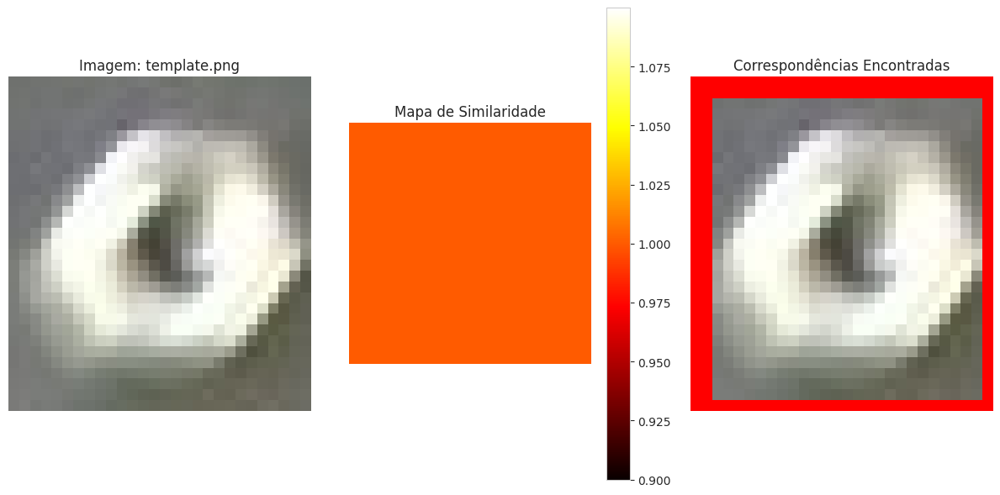

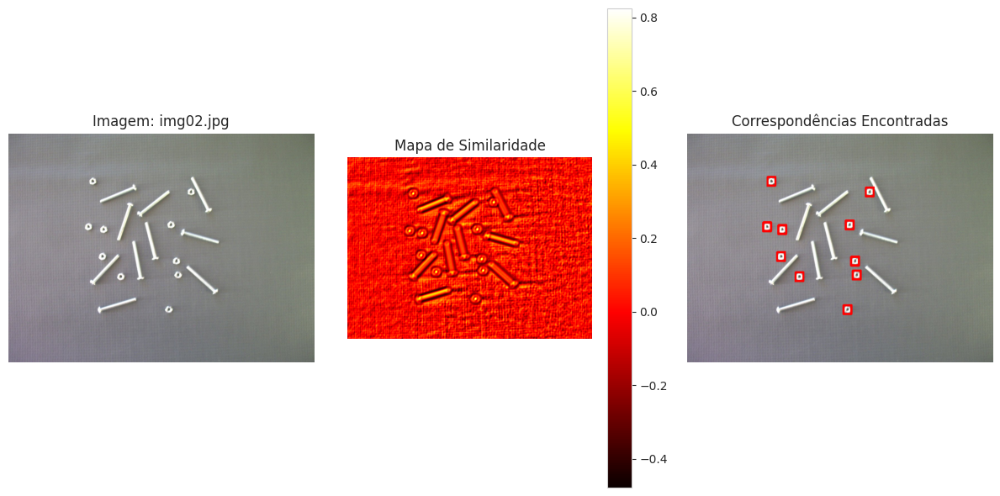

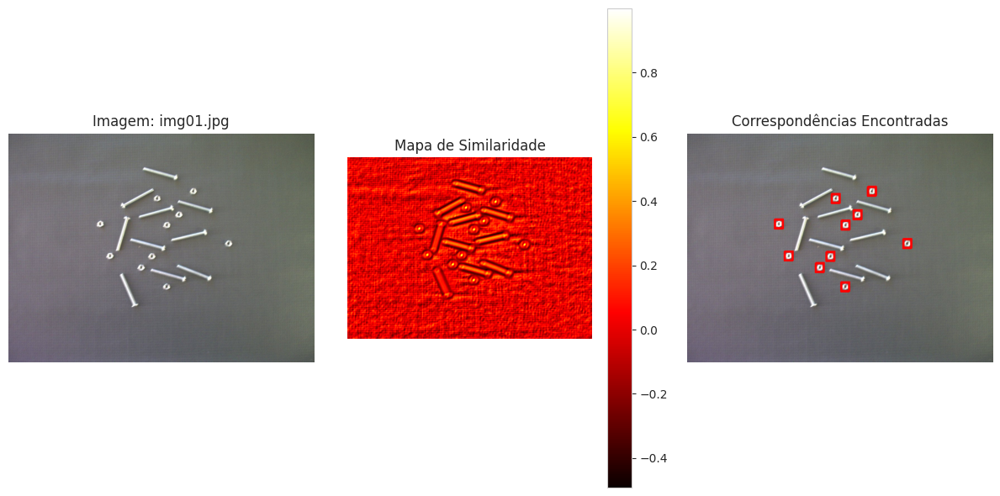

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import pandas as pd

# Caminho para o diretório contendo as imagens
image_dir = "imagens/template_matching"  # Substitua pelo diretório com as imagens
template_path = "imagens/template_matching/template.png"  # Caminho para o template

# Carregar o template e converter para escala de cinza
template = cv2.imread(template_path, cv2.IMREAD_COLOR)
template_gray = cv2.cvtColor(template, cv2.COLOR_BGR2GRAY)

# Obter dimensões do template
template_height, template_width = template_gray.shape

# Limite de similaridade para considerar uma correspondência
threshold = 0.6

# Listar todas as imagens no diretório
image_files = [f for f in os.listdir(image_dir) 
               if f.endswith(('.jpg', '.png', '.jpeg')) and f != os.path.basename(template_path)]

# Lista para armazenar os resultados
results = []

# Processar cada imagem no diretório
for image_file in image_files:
    image_path = os.path.join(image_dir, image_file)
    image = cv2.imread(image_path, cv2.IMREAD_COLOR)

    # Converter a imagem para escala de cinza
    image_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Aplicar template matching
    result = cv2.matchTemplate(image_gray, template_gray, cv2.TM_CCOEFF_NORMED)

    # Obter a localização do valor máximo de correspondência
    min_val, max_val, min_loc, max_loc = cv2.minMaxLoc(result)

    # Armazenar o resultado
    results.append({
        "Image": image_file,
        "Max Match Value": max_val,
        "Top Left Corner": max_loc,
        "Bottom Right Corner": (max_loc[0] + template_width, max_loc[1] + template_height)
    })

    # Desenhar o retângulo na imagem original
    output_image = image.copy()
    if max_val >= threshold:
        cv2.rectangle(output_image, max_loc, 
                      (max_loc[0] + template_width, max_loc[1] + template_height), 
                      (0, 255, 0), 2)

    # Mostrar os resultados
    plt.figure(figsize=(12, 6))

    # Imagem original com correspondências
    plt.subplot(1, 3, 1)
    plt.title(f"Imagem: {image_file}")
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    # Mapa de similaridade
    plt.subplot(1, 3, 2)
    plt.title("Mapa de Similaridade")
    plt.imshow(result, cmap='hot')
    plt.colorbar()
    plt.axis('off')

    # Imagem com correspondências destacadas
    plt.subplot(1, 3, 3)
    plt.title("Correspondência Mais Alta")
    plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))
    plt.axis('off')

    plt.tight_layout()
    plt.show()

# Criar um DataFrame com os resultados
df_results = pd.DataFrame(results)

# Exibir o DataFrame
# import ace_tools as tools; tools.display_dataframe_to_user(name="Resultados do Template Matching", dataframe=df_results)
